#**License Plate Recognition**



#1. Data Loading, Pre-processing, data analysis, and understanding

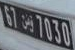

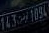

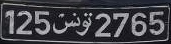

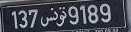

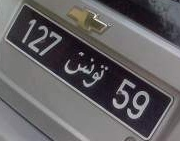

...

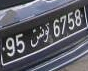

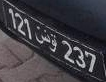

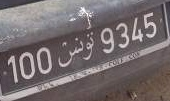

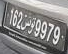

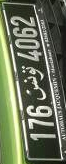

In [1]:
import pandas as pd
import cv2
import os
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load CSV files
detection_df = pd.read_csv('/content/Licplatesdetection_train.csv')
recognition_df = pd.read_csv('/content/Licplatesrecognition_train.csv')

# Load images for detection and recognition
detection_images_path = '/content/sample_data/Licplatesdetection_train'
recognition_images_path = '/content/sample_data/Licplatesrecognition_train'

# Example of loading a detection image and corresponding annotation
for i, row in detection_df.iterrows():
    img_path = os.path.join(detection_images_path, row['img_id'])
    img = cv2.imread(img_path)

    if img is None:
        print(f"Error: Image at path {img_path} could not be loaded.")
        continue  # Skip this iteration if the image can't be loaded

    # Get bounding box coordinates and crop the license plate
    ymin, xmin, ymax, xmax = int(row['ymin']), int(row['xmin']), int(row['ymax']), int(row['xmax'])
    license_plate = img[ymin:ymax, xmin:xmax]  # Cropping license plate region

    # Display the cropped license plate using cv2_imshow
    cv2_imshow(license_plate)


#2. Data exploration - EDA Exploratory Data Analysis

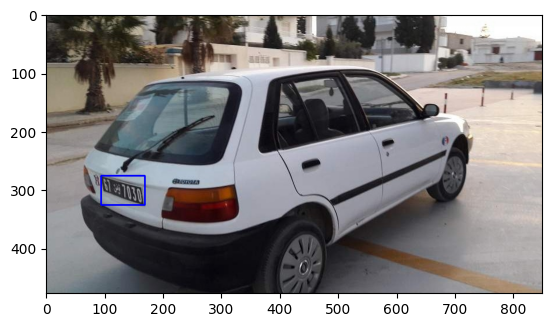

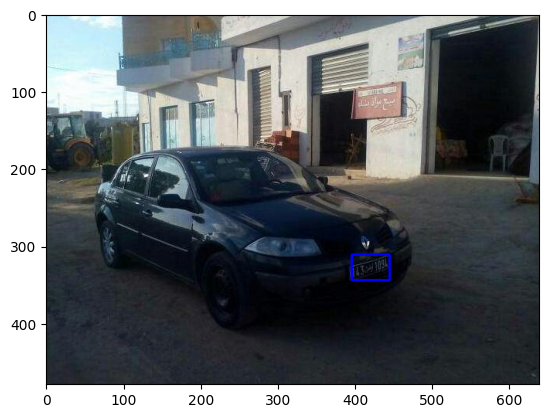

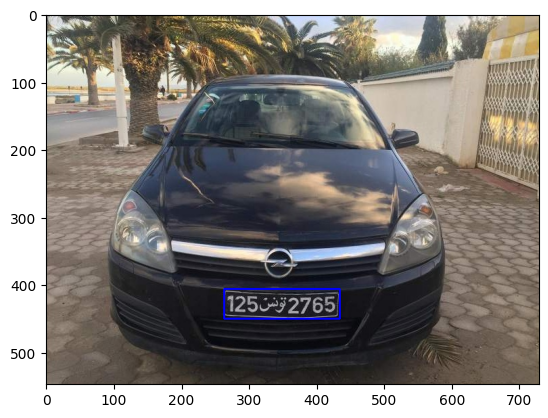

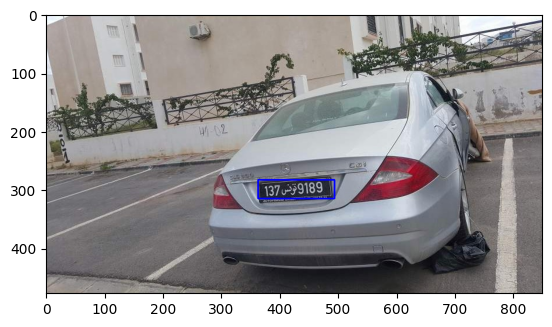

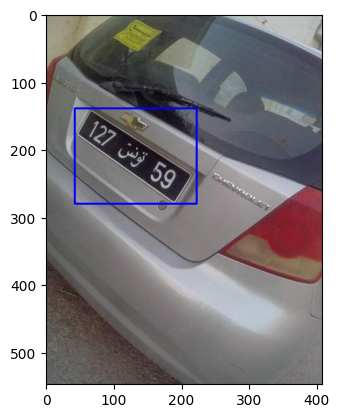

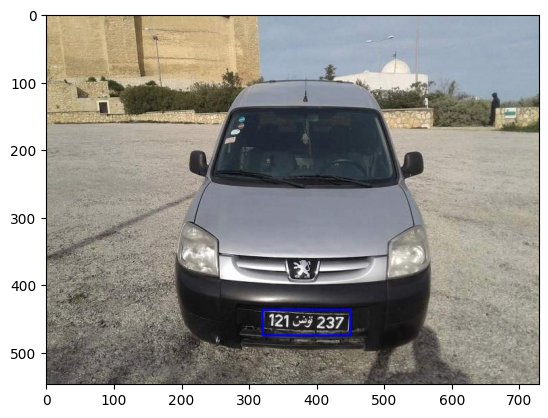

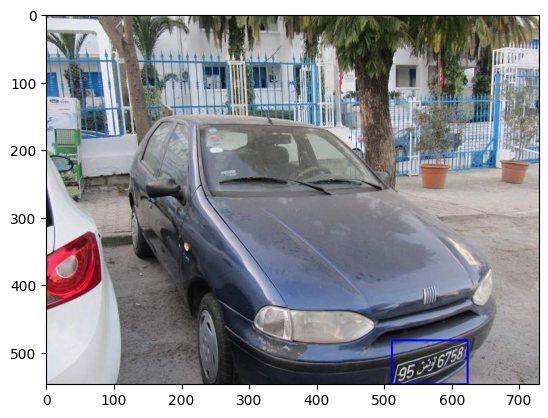

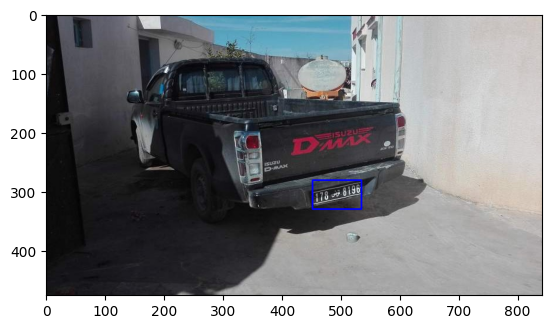

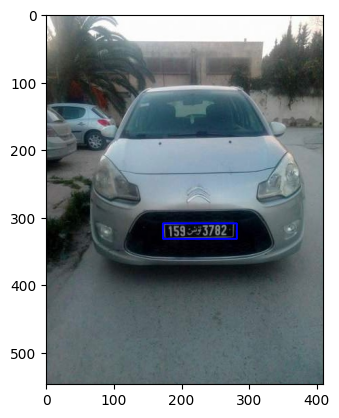

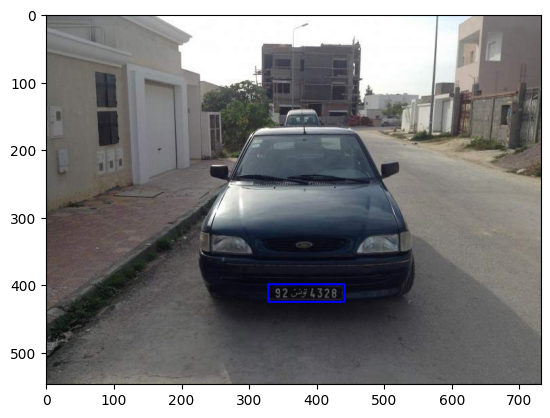

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns

# Visualize some of the bounding boxes from detection dataset
def plot_bounding_boxes(df, img_folder):
    for i in range(10):  # Display 5 samples
        img_path = os.path.join(img_folder, df.iloc[i]['img_id'])
        img = cv2.imread(img_path)
        ymin, xmin, ymax, xmax = df.iloc[i]['ymin'], df.iloc[i]['xmin'], df.iloc[i]['ymax'], df.iloc[i]['xmax']
        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.show()

plot_bounding_boxes(detection_df, detection_images_path)

This visualization helps to inspect the quality of the detected bounding boxes, ensuring that they correctly encompass the license plates. It allows for a quick visual verification of the detection performance and can help identify any issues with misaligned or incorrectly sized bounding boxes.

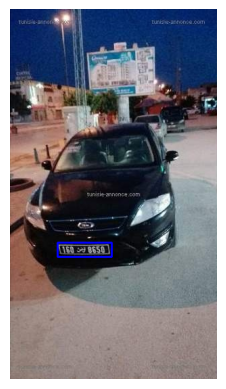

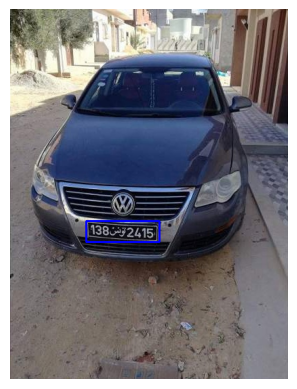

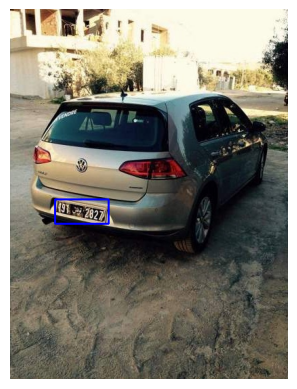

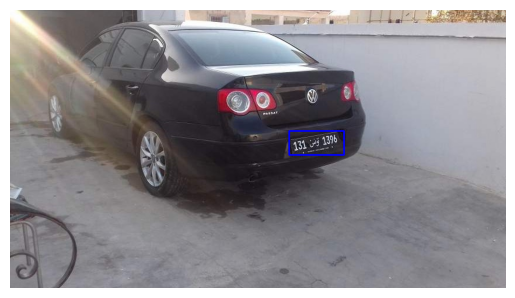

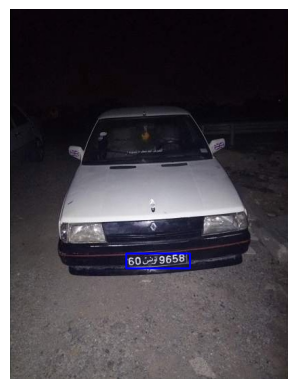

In [10]:
import random

def plot_random_bounding_boxes(df, img_folder, num_samples=5):
    # Exclude the first 5 rows and select random samples
    available_indices = df.index[5:]  # Skip the first 5 indices
    random_indices = random.sample(list(available_indices), num_samples)  # Randomly select 5 indices

    for i in random_indices:
        img_path = os.path.join(img_folder, df.iloc[i]['img_id'])
        img = cv2.imread(img_path)

        if img is not None:
            ymin, xmin, ymax, xmax = (
                int(df.iloc[i]['ymin']),
                int(df.iloc[i]['xmin']),
                int(df.iloc[i]['ymax']),
                int(df.iloc[i]['xmax']),
            )
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.axis('off')  # Turn off axis numbers and ticks
            plt.show()

# Call the function to plot random bounding boxes
plot_random_bounding_boxes(detection_df, detection_images_path)


The above one is the same but with 5 random objects from the dataset.

In [11]:
# detection_df
# recognition_df
# test_images_path

# Display the first few rows of each dataset
print("Detection data Sample:")
print(detection_df.head())

print("\nRecognition Data Sample:")
print(recognition_df.head())

Detection data Sample:
    img_id  ymin  xmin  ymax  xmax  box_width  box_height
0    1.jpg   276    94   326   169         75          50
1   10.jpg   311   395   344   444         49          33
2  100.jpg   406   263   450   434        171          44
3  101.jpg   283   363   315   494        131          32
4  102.jpg   139    42   280   222        180         141

Recognition Data Sample:
    img_id      text
0    0.jpg  117T3989
1    1.jpg  128T8086
2   10.jpg   94T3458
3  100.jpg  133T6719
4  101.jpg   68T5979


The look into the datasets.

In [12]:
# Display the shape and data types
print("Detection data Sample:")
print(detection_df.info())

print("\nRecognition Data Sample:")
print(recognition_df.info())

Detection data Sample:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900 entries, 0 to 899
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   img_id      900 non-null    object
 1   ymin        900 non-null    int64 
 2   xmin        900 non-null    int64 
 3   ymax        900 non-null    int64 
 4   xmax        900 non-null    int64 
 5   box_width   900 non-null    int64 
 6   box_height  900 non-null    int64 
dtypes: int64(6), object(1)
memory usage: 49.3+ KB
None

Recognition Data Sample:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900 entries, 0 to 899
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   img_id  900 non-null    object
 1   text    900 non-null    object
dtypes: object(2)
memory usage: 14.2+ KB
None


A brief info fo the datasets given.

In [13]:
print("Detection data Sample:")
print(detection_df.isnull().sum())

print("\nRecognition Data Sample:")
print(recognition_df.isnull().sum())

Detection data Sample:
img_id        0
ymin          0
xmin          0
ymax          0
xmax          0
box_width     0
box_height    0
dtype: int64

Recognition Data Sample:
img_id    0
text      0
dtype: int64


Checking for the null values.

In [14]:
print("Detection data Sample:")
print(detection_df.describe())

print("\nRecognition Data Sample:")
print(recognition_df.describe())

Detection data Sample:
             ymin        xmin        ymax        xmax   box_width  box_height
count  900.000000  900.000000  900.000000  900.000000  900.000000  900.000000
mean   308.596667  240.044444  356.741111  368.750000  128.705556   48.144444
std     75.768988  142.368243   71.955977  149.029253   50.294405   33.908094
min     14.000000    1.000000  121.000000   84.000000   25.000000   13.000000
25%    263.000000  129.000000  313.000000  245.750000   96.000000   30.000000
50%    314.000000  212.000000  359.000000  338.000000  122.000000   38.500000
75%    363.000000  320.250000  410.000000  485.250000  157.000000   53.000000
max    525.000000  698.000000  547.000000  823.000000  392.000000  281.000000

Recognition Data Sample:
       img_id      text
count     900       900
unique    900       596
top     0.jpg  106T2131
freq        1        10


The description of the dataset.

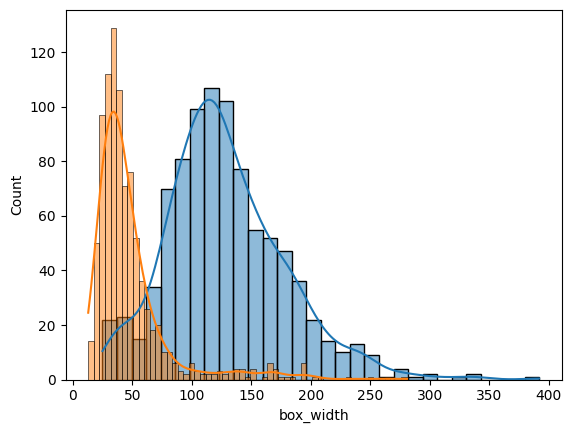

In [9]:
# Analyze distribution of bounding box sizes
detection_df['box_width'] = detection_df['xmax'] - detection_df['xmin']
detection_df['box_height'] = detection_df['ymax'] - detection_df['ymin']
sns.histplot(detection_df['box_width'], kde=True)
sns.histplot(detection_df['box_height'], kde=True)
plt.show()

Bounding Box Width and Height Calculation:
It computes the width and height of each bounding box by subtracting the minimum coordinates from the maximum coordinates (box_width and box_height).

Distribution Visualization:
Two histograms are generated using Seaborn (sns.histplot), one for the widths and one for the heights. Each histogram includes a Kernel Density Estimate (KDE) overlay for a smoother representation of the data distribution.

In [15]:
!pip install seaborn
import matplotlib.pyplot as plt
import seaborn as sns # Import seaborn for plotting

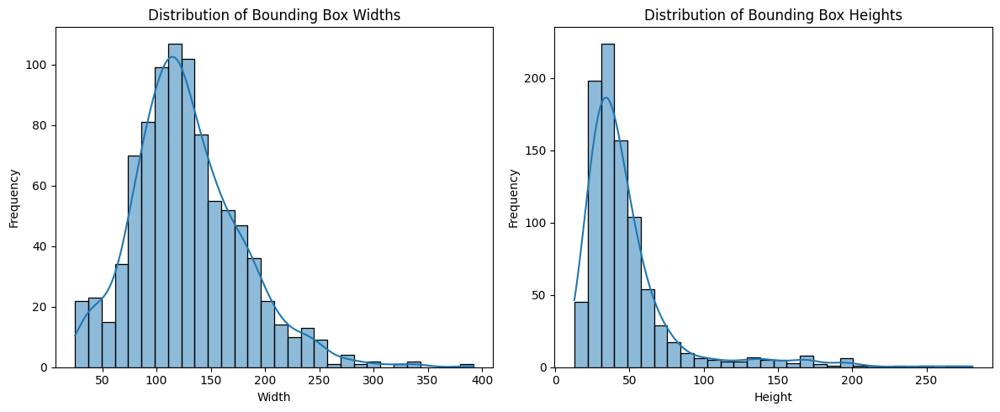

In [17]:
# Create new columns for bounding box dimensions
detection_df['box_width'] = detection_df['xmax'] - detection_df['xmin']
detection_df['box_height'] = detection_df['ymax'] - detection_df['ymin']

# Visualizing the distribution of bounding box sizes
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.histplot(detection_df['box_width'], bins=30, kde=True)
plt.title('Distribution of Bounding Box Widths')
plt.xlabel('Width')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
sns.histplot(detection_df['box_height'], bins=30, kde=True)
plt.title('Distribution of Bounding Box Heights')
plt.xlabel('Height')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

New Columns: It creates box_width and box_height columns in the DataFrame by calculating the differences between the corresponding coordinates of the bounding boxes which are the number plates itself.

Purpose: This analysis helps identify common dimensions, detect outliers, and assess the effectiveness of the detection model, guiding potential optimizations.

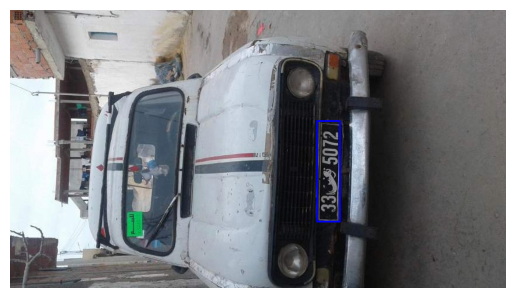

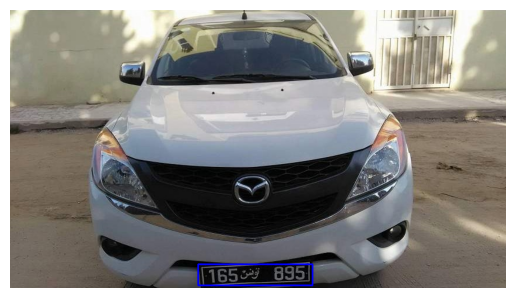

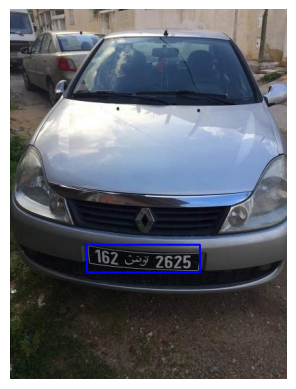

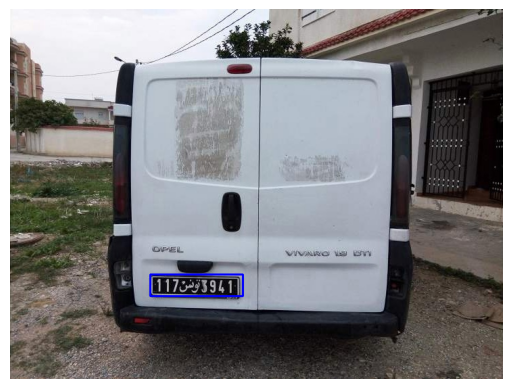

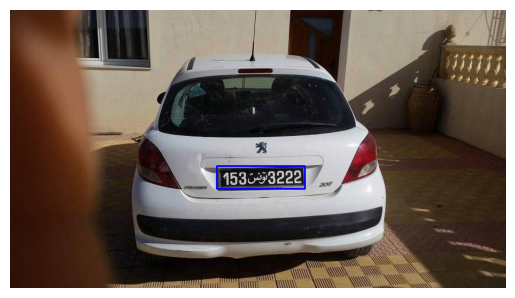

In [18]:
def plot_more_bounding_boxes(df, img_folder, num_samples=5):
    random_indices = random.sample(range(len(df)), num_samples)  # Randomly select samples

    for i in random_indices:
        img_path = os.path.join(img_folder, df.iloc[i]['img_id'])
        img = cv2.imread(img_path)

        if img is not None:
            ymin, xmin, ymax, xmax = (
                int(df.iloc[i]['ymin']),
                int(df.iloc[i]['xmin']),
                int(df.iloc[i]['ymax']),
                int(df.iloc[i]['xmax']),
            )
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.axis('off')  # Turn off axis numbers and ticks
            plt.show()

# Call the function to visualize more samples
plot_more_bounding_boxes(detection_df, detection_images_path, num_samples=5)


Again any random 5 samples.

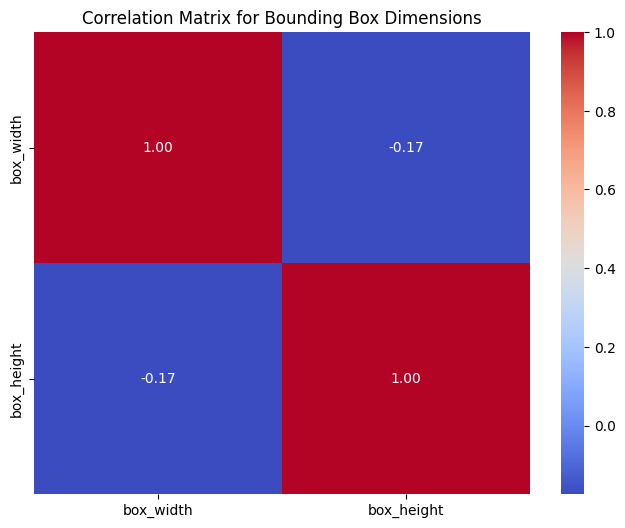

In [21]:
# Correlation heatmap for bounding box dimensions
plt.figure(figsize=(8, 6))
correlation_matrix = detection_df[['box_width', 'box_height']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix for Bounding Box Dimensions')
plt.show()

This is a correlation matrix, and it calculates the correlation coefficients between the box_width and box_height columns of the detection_df DataFrame. This matrix shows how strongly these dimensions are related to each other.

The Purpose of this would be, analysis that helps to understand the relationship between width and height of the bounding boxes, indicating whether changes in one dimension are associated with changes in the other. A strong correlation could imply a consistent aspect ratio in the bounding boxes.

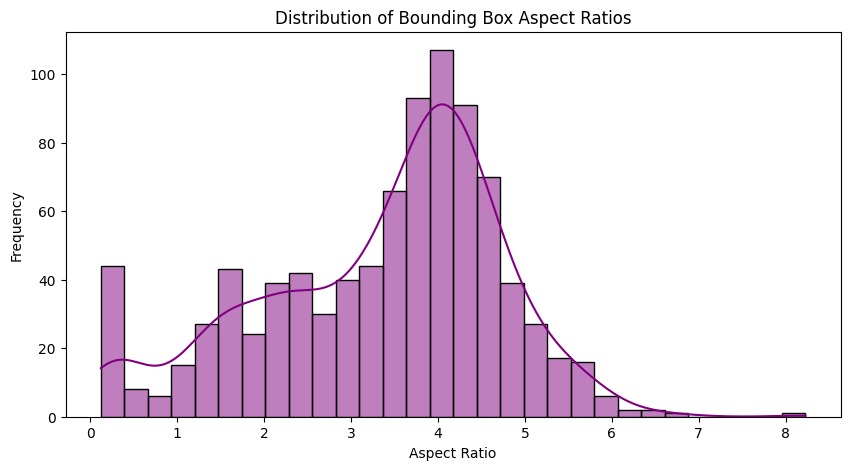

In [22]:
# Calculate aspect ratio
detection_df['aspect_ratio'] = detection_df['box_width'] / detection_df['box_height']

# Visualize aspect ratio distribution
plt.figure(figsize=(10, 5))
sns.histplot(detection_df['aspect_ratio'], bins=30, kde=True, color='purple')
plt.title('Distribution of Bounding Box Aspect Ratios')
plt.xlabel('Aspect Ratio')
plt.ylabel('Frequency')
plt.show()

There is a new column, aspect_ratio, represents the relationship between the width and height of the bounding boxes.

This analysis helps to understand how the dimensions of the bounding boxes vary in terms of their shape. A consistent aspect ratio across bounding boxes may indicate uniformity in the size and shape of the detected objects, which in this case are likely license plates.

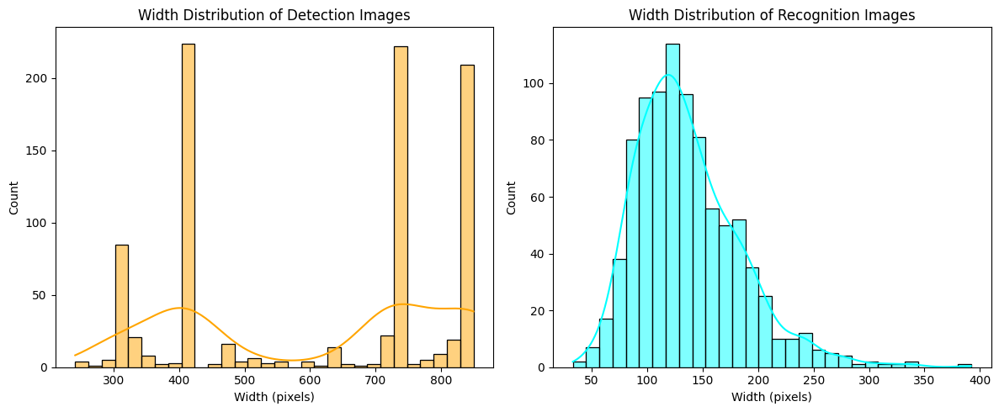

In [23]:
# Function to get image dimensions
def get_image_dimensions(img_folder):
    widths, heights = [], []
    for img_file in os.listdir(img_folder):
        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)
        if img is not None:
            heights.append(img.shape[0])
            widths.append(img.shape[1])
    return widths, heights

detection_widths, detection_heights = get_image_dimensions(detection_images_path)
recognition_widths, recognition_heights = get_image_dimensions(recognition_images_path)

# Plot the distribution of image dimensions
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(detection_widths, bins=30, kde=True, color='orange')
plt.title('Width Distribution of Detection Images')
plt.xlabel('Width (pixels)')

plt.subplot(1, 2, 2)
sns.histplot(recognition_widths, bins=30, kde=True, color='cyan')
plt.title('Width Distribution of Recognition Images')
plt.xlabel('Width (pixels)')

plt.tight_layout()
plt.show()

This basically shows us the graph of how the width(in terms of pixels) differs in the detection dataset and the recognition dataset and this helps identify the range and frequency of image sizes, providing insights into the variability of image dimensions within the datasets.

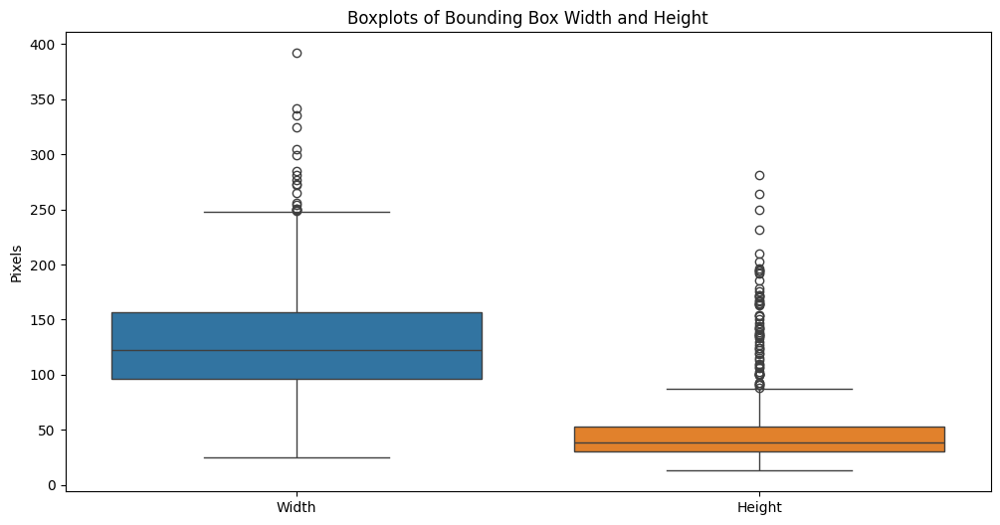

In [24]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=detection_df[['box_width', 'box_height']])
plt.title('Boxplots of Bounding Box Width and Height')
plt.ylabel('Pixels')
plt.xticks([0, 1], ['Width', 'Height'])
plt.show()

The most efficint way to showcase the Width and Height ranges in the dataset.
Width  -> 100 - 120

Height -> 30 - 50

In [26]:
import numpy as np

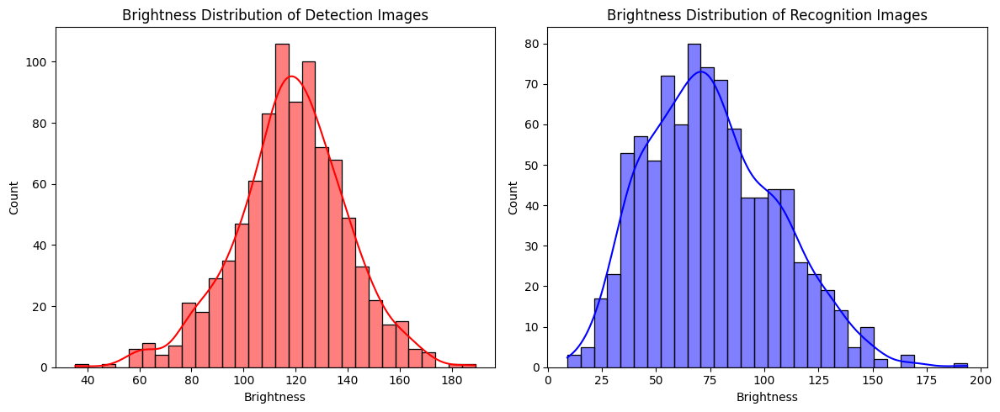

In [27]:
def compute_image_brightness(img_folder):
    brightness = []
    for img_file in os.listdir(img_folder):
        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)
        if img is not None:
            brightness.append(np.mean(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)))
    return brightness

detection_brightness = compute_image_brightness(detection_images_path)
recognition_brightness = compute_image_brightness(recognition_images_path)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(detection_brightness, bins=30, kde=True, color='red')
plt.title('Brightness Distribution of Detection Images')
plt.xlabel('Brightness')

plt.subplot(1, 2, 2)
sns.histplot(recognition_brightness, bins=30, kde=True, color='blue')
plt.title('Brightness Distribution of Recognition Images')
plt.xlabel('Brightness')

plt.tight_layout()
plt.show()

Brightness Calculation: For each image, it converts the image to grayscale and calculates the average brightness value, storing these values in a list.

Visualization: It then creates histograms for both datasets:

Detection Images: Brightness distribution is plotted in red.
Recognition Images: Brightness distribution is plotted in blue.

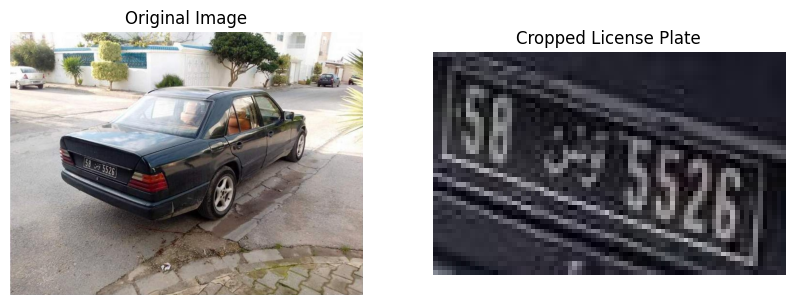

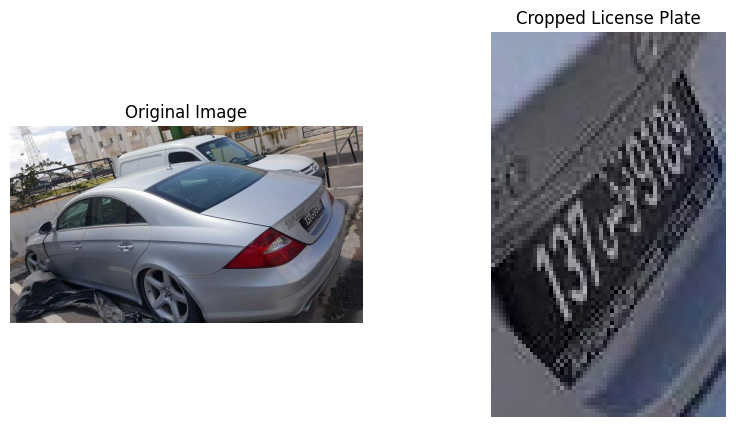

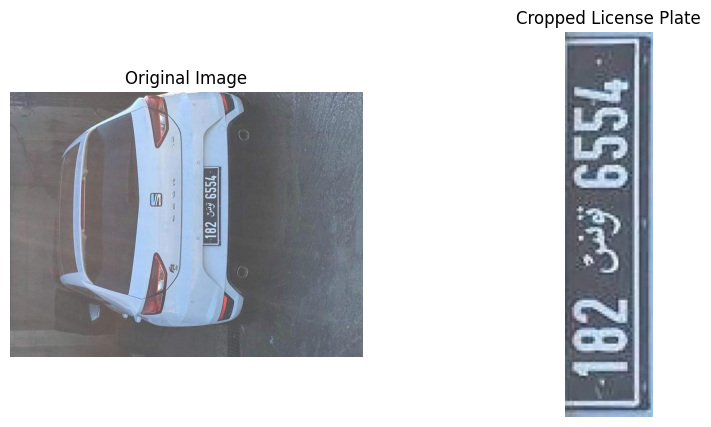

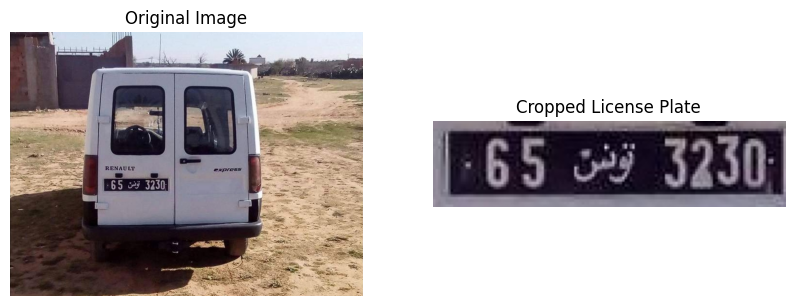

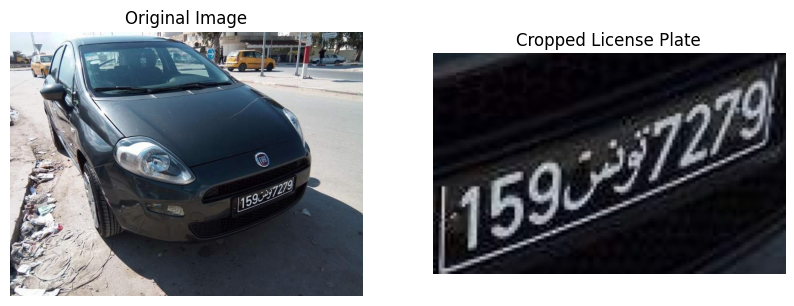

In [28]:
def plot_sample_images_with_crops(df, img_folder, num_samples=5):
    random_indices = random.sample(range(len(df)), num_samples)  # Randomly select samples

    for i in random_indices:
        img_path = os.path.join(img_folder, df.iloc[i]['img_id'])
        img = cv2.imread(img_path)
        ymin, xmin, ymax, xmax = df.iloc[i]['ymin'], df.iloc[i]['xmin'], df.iloc[i]['ymax'], df.iloc[i]['xmax']
        license_plate_crop = img[ymin:ymax, xmin:xmax]  # Crop the license plate region

        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(license_plate_crop, cv2.COLOR_BGR2RGB))
        plt.title('Cropped License Plate')
        plt.axis('off')

        plt.show()

plot_sample_images_with_crops(detection_df, detection_images_path, num_samples=5)

This does crop out the number plates out of the main image i.e., fetching data to recognize from the detection step.

It creates a side-by-side plot for each sample.

*   The left side displays the original image.
*  The right side shows the cropped license plate region.
*   Each image is displayed without axes for better visual clarity.










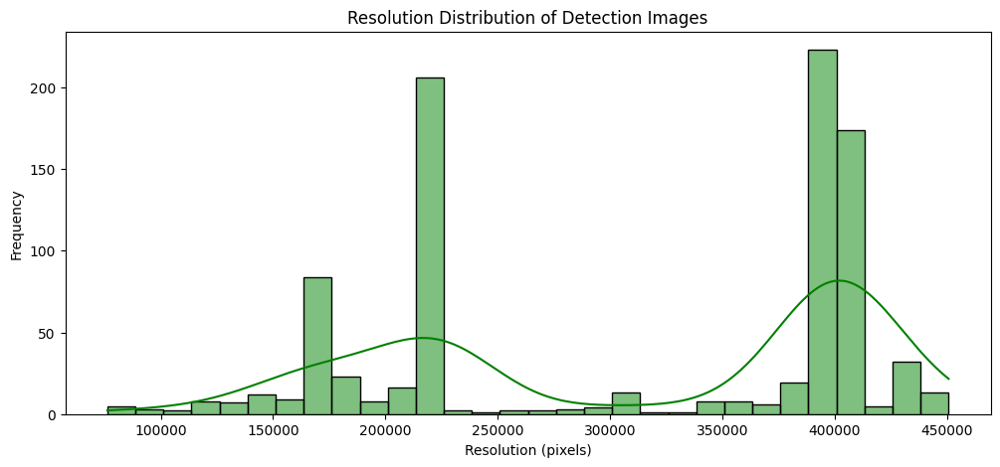

In [29]:
# Function to calculate image resolutions
def get_image_resolutions(img_folder):
    resolutions = []
    for img_file in os.listdir(img_folder):
        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)
        if img is not None:
            resolutions.append(img.shape[0] * img.shape[1])  # Height * Width
    return resolutions

detection_resolutions = get_image_resolutions(detection_images_path)
recognition_resolutions = get_image_resolutions(recognition_images_path)

plt.figure(figsize=(12, 5))
sns.histplot(detection_resolutions, bins=30, kde=True, color='green')
plt.title('Resolution Distribution of Detection Images')
plt.xlabel('Resolution (pixels)')
plt.ylabel('Frequency')
plt.show()

The frequency(number of images) of the dataset distributed based on the clarity/Resolution i.e., the pixel number

The function get_image_resolutions iterates over all image files in the specified folder. For each image, it reads the image and computes its resolution by multiplying the height (img.shape[0]) by the width (img.shape[1]). The computed resolutions are stored in a list.

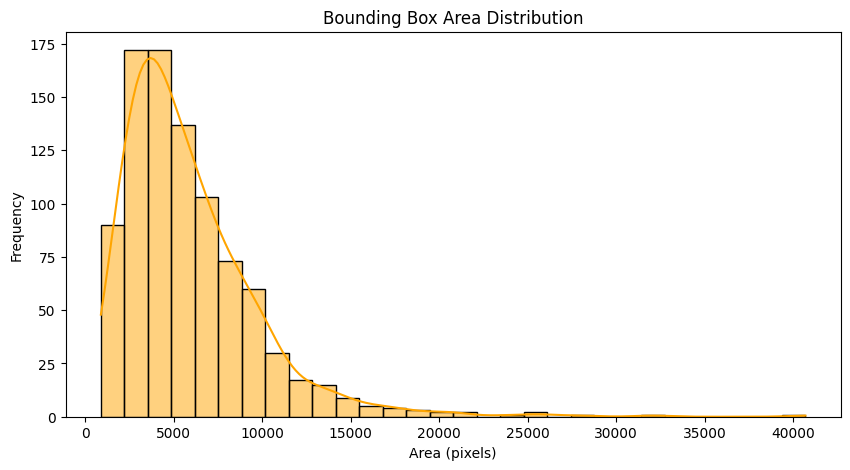

In [30]:
# Calculate bounding box area
detection_df['box_area'] = (detection_df['xmax'] - detection_df['xmin']) * (detection_df['ymax'] - detection_df['ymin'])

# Visualize bounding box area distribution
plt.figure(figsize=(10, 5))
sns.histplot(detection_df['box_area'], bins=30, kde=True, color='orange')
plt.title('Bounding Box Area Distribution')
plt.xlabel('Area (pixels)')
plt.ylabel('Frequency')
plt.show()

More depth about the resolution as this visualization helps in understanding the distribution of bounding box sizes, indicating the commonality of certain area sizes and any potential outliers in the dataset.

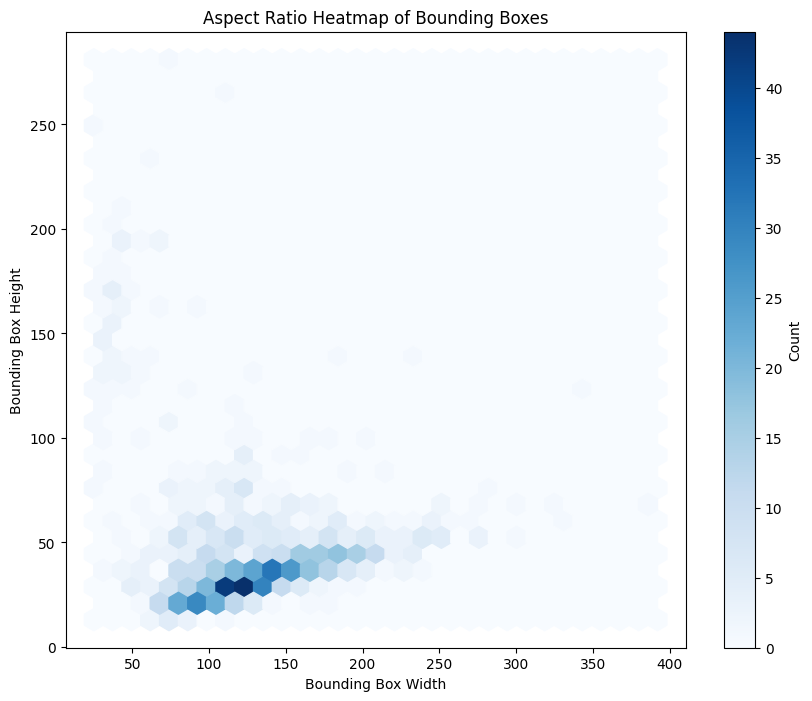

In [31]:
plt.figure(figsize=(10, 8))
plt.hexbin(detection_df['box_width'], detection_df['box_height'], gridsize=30, cmap='Blues')
plt.colorbar(label='Count')
plt.title('Aspect Ratio Heatmap of Bounding Boxes')
plt.xlabel('Bounding Box Width')
plt.ylabel('Bounding Box Height')
plt.show()

This hexbin plot helps identify the density and distribution of bounding box dimensions, making it easier to spot common dimensions and understand the relationship between width and height in the dataset.

#3.Model building

In [35]:
!sudo apt install tesseract-ocr
!pip install pytesseract

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 49 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 2s (2,035 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [36]:
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 17022, done.
remote: Counting objects: 100% (217/217), done.
remote: Compressing objects: 100% (146/146), done.
remote: Total 17022 (delta 122), reused 131 (delta 71), pack-reused 16805 (from 1)
Receiving objects: 100% (17022/17022), 15.74 MiB | 11.59 MiB/s, done.
Resolving deltas: 100% (11660/11660), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 876.6/876.6 kB 15.3 MB/s eta 0:00:00


#4.Result and Accuracy of the character recognition from the license plate

In [37]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 21.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 36.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 13.8 MB/s eta 0:00:00


In [39]:
# Install EasyOCR if not already installed
!pip install easyocr

# Import necessary libraries
import cv2
import os
import pandas as pd
import easyocr
import numpy as np

# Initialize EasyOCR reader for English
reader = easyocr.Reader(['en'])

# Function to recognize text from the license plate
def recognize_license_plate_text(license_plate_img):
    # Preprocess the image: convert to grayscale and apply thresholding
    gray_img = cv2.cvtColor(license_plate_img, cv2.COLOR_BGR2GRAY)
    _, thresh_img = cv2.threshold(gray_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Use EasyOCR to recognize text
    result = reader.readtext(thresh_img)

    # Extract recognized text
    recognized_text = ''.join([text[1] for text in result])
    return recognized_text.strip()

# Function to create one-hot encoding for the recognized digits (0-9)
def create_digit_one_hot_encoding(recognized_text):
    one_hot = [0] * 10  # Initialize with 10 zeros (for digits 0-9)

    for char in recognized_text:
        if char.isdigit():  # Check if the character is a digit
            one_hot[int(char)] = 1  # Set the respective index to 1

    return one_hot

# Function to process the test images in the specified folder and save the results
def process_test_images(img_folder, output_csv):
    results = []
    image_files = [f for f in os.listdir(img_folder) if f.endswith(('.jpg', '.png'))]  # Adjust based on your image formats

    for i, img_file in enumerate(image_files):
        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)

        if img is None:
            print(f"Error: Image at path {img_path} could not be loaded.")
            continue

        # Assuming the license plate is the whole image, if you have bounding box logic apply it here
        license_plate_img = img  # Change this if you have cropping logic

        # Recognize the text from the license plate
        recognized_text = recognize_license_plate_text(license_plate_img)

        # Create one-hot encoding for the recognized digits
        one_hot_encoding = create_digit_one_hot_encoding(recognized_text)

        # Prepare the row to append to the results (id + one-hot encoding)
        img_id = f"img_{i+901}_{1}"  # For example: img_901_1, img_901_2, etc.
        result_row = [img_id] + one_hot_encoding
        results.append(result_row)

    # Create DataFrame and save as CSV
    columns = ['id'] + [str(i) for i in range(10)]  # 'id', '0', '1', ..., '9'
    results_df = pd.DataFrame(results, columns=columns)

    # Save to CSV
    results_df.to_csv(output_csv, index=False)
    print(f"Results saved to {output_csv}")

# Example usage
test_images_path = '/content/sample_data/test'  # Adjust to your test images folder
output_csv_path = '/content/SUB.csv'  # Adjust as needed

process_test_images(test_images_path, output_csv_path)


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% CompleteResults saved to /content/SUB.csv
